In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
%env SM_FRAMEWORK=tf.keras

!pip install segmentation-models       # for UNET
!pip install patchify                  # to split and merge large images into smaller patches

env: SM_FRAMEWORK=tf.keras
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# import libraries
import numpy as np
from matplotlib import pyplot as plt
from patchify import patchify, unpatchify
import cv2
from google.colab.patches import cv2_imshow
from keras.utils import normalize
import random
import numpy as np
from tensorflow.keras.callbacks import * # ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
import segmentation_models as sm
from keras.preprocessing.image import ImageDataGenerator
import os

Segmentation Models: using `tf.keras` framework.


2.tif
(1536, 2048)


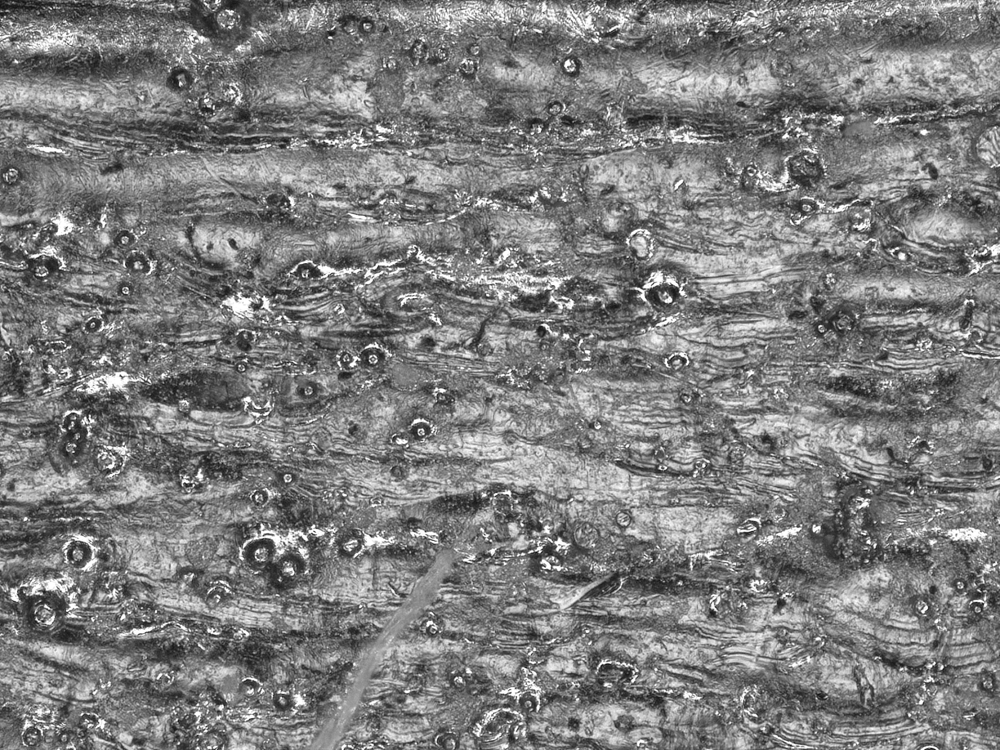

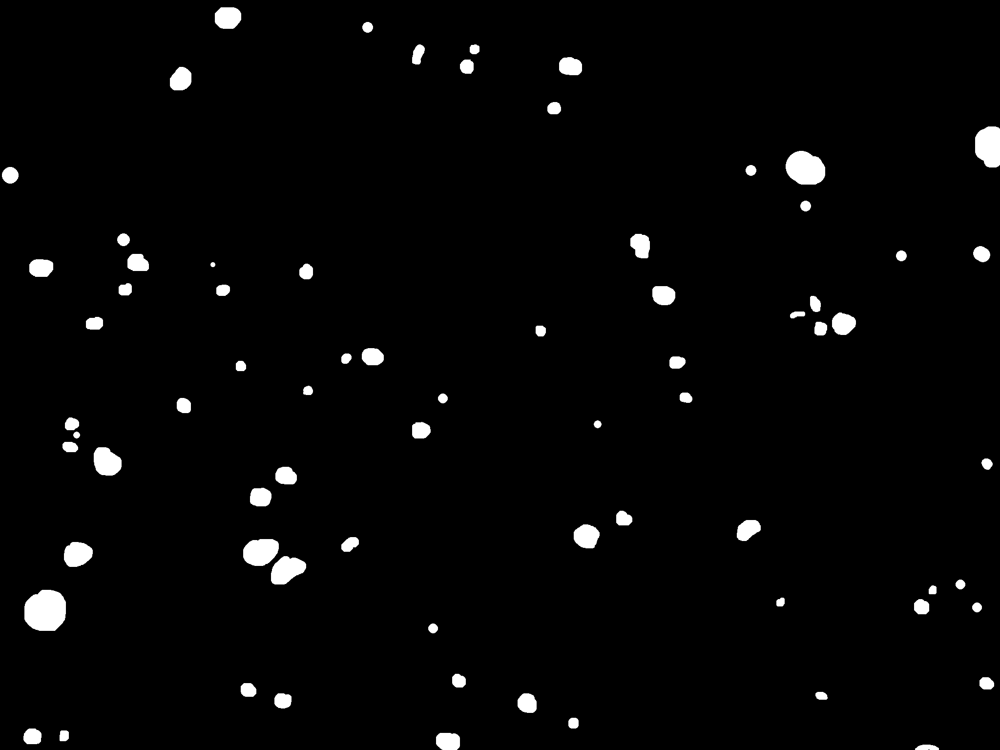

--------------------
4.tif
(1536, 2048)


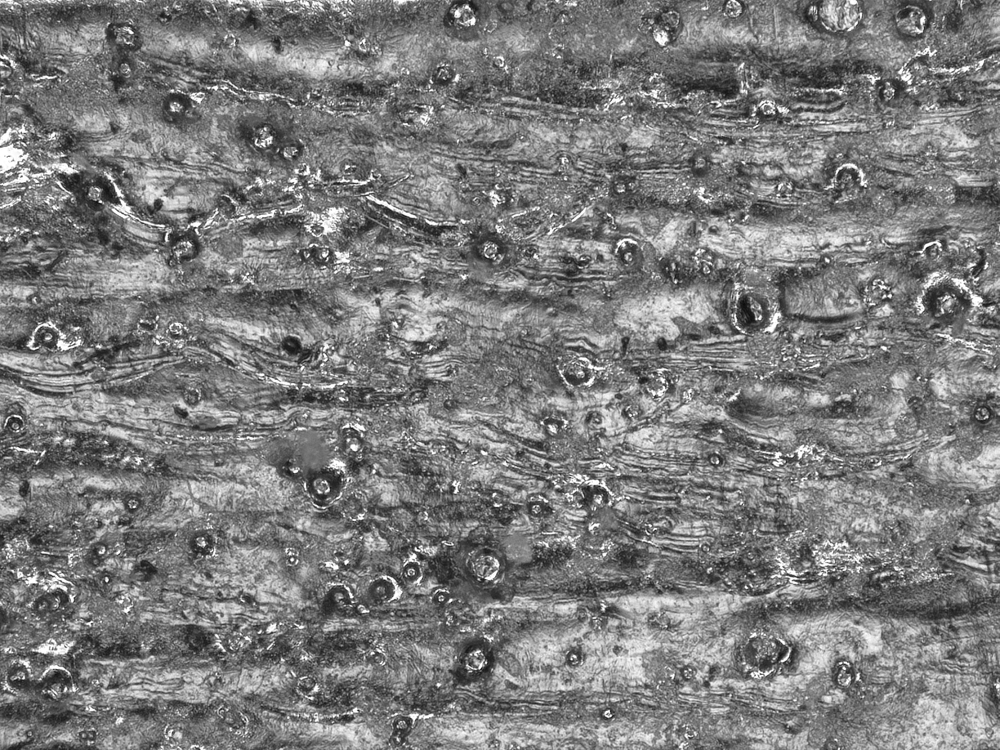

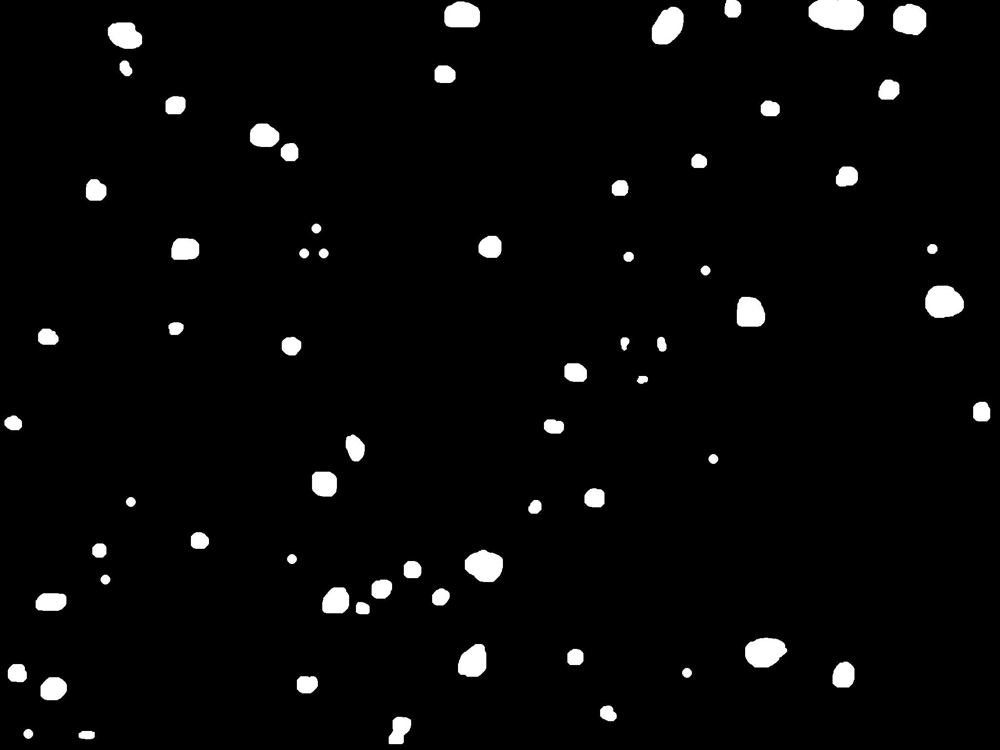

--------------------
8.tif
(1536, 2048)


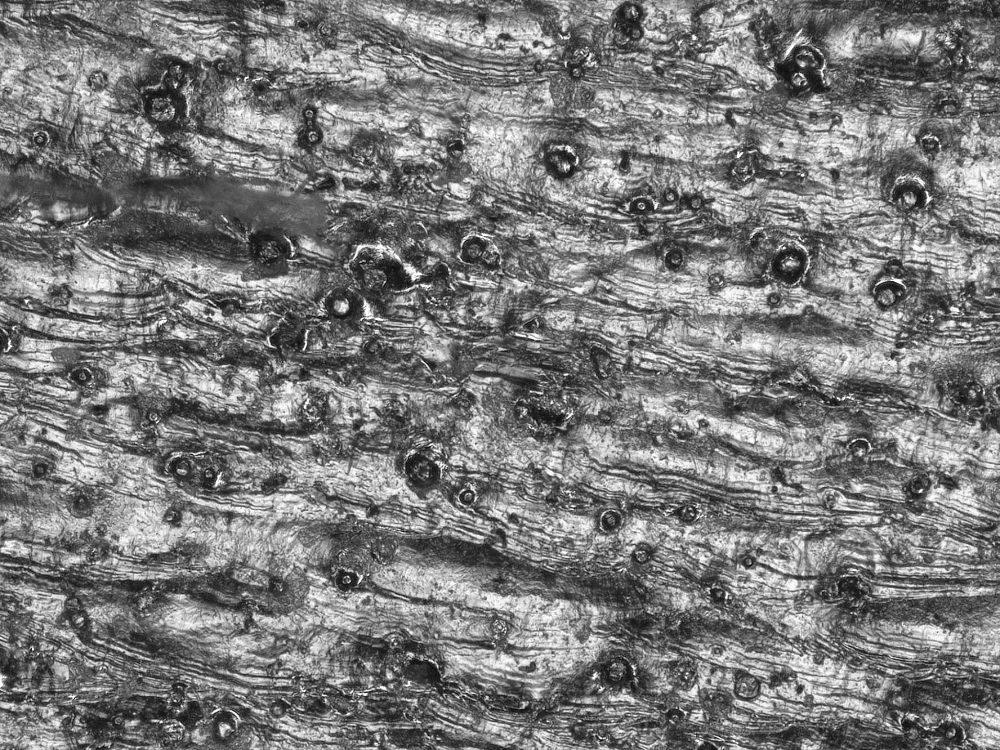

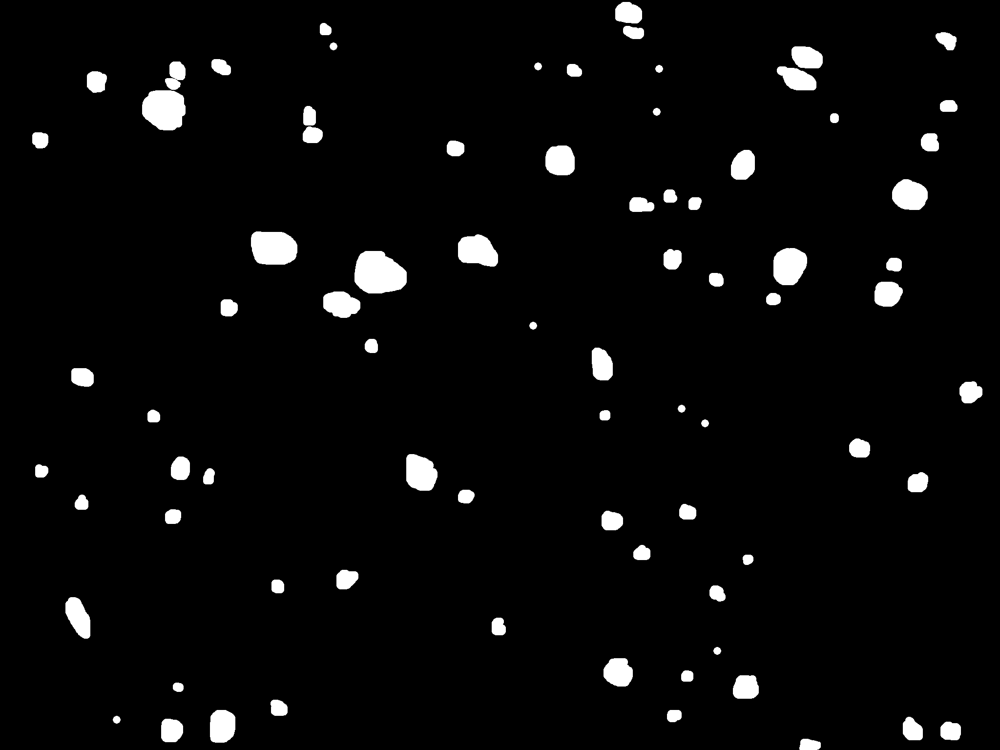

--------------------
17.tif
(1536, 2048)


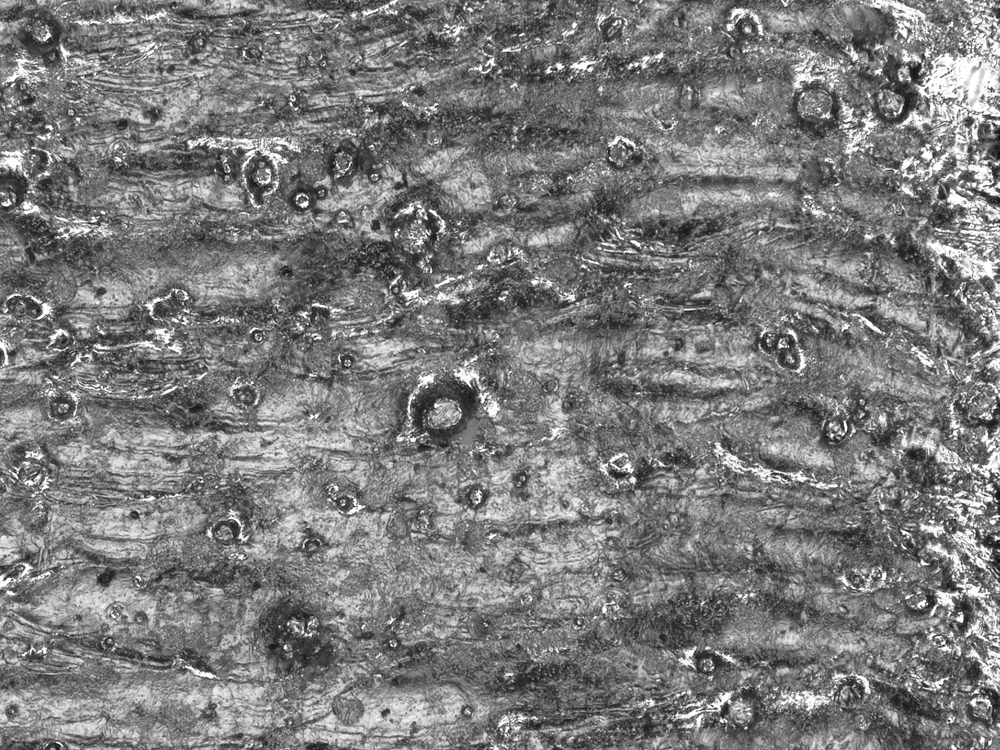

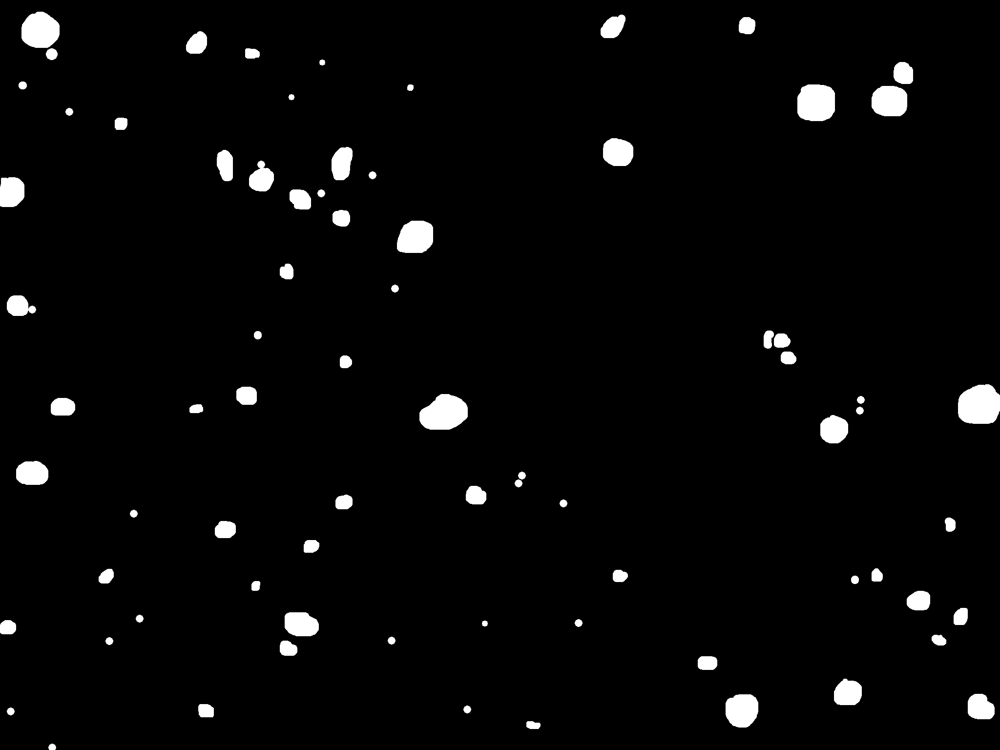

--------------------
18.tif
(1536, 2048)


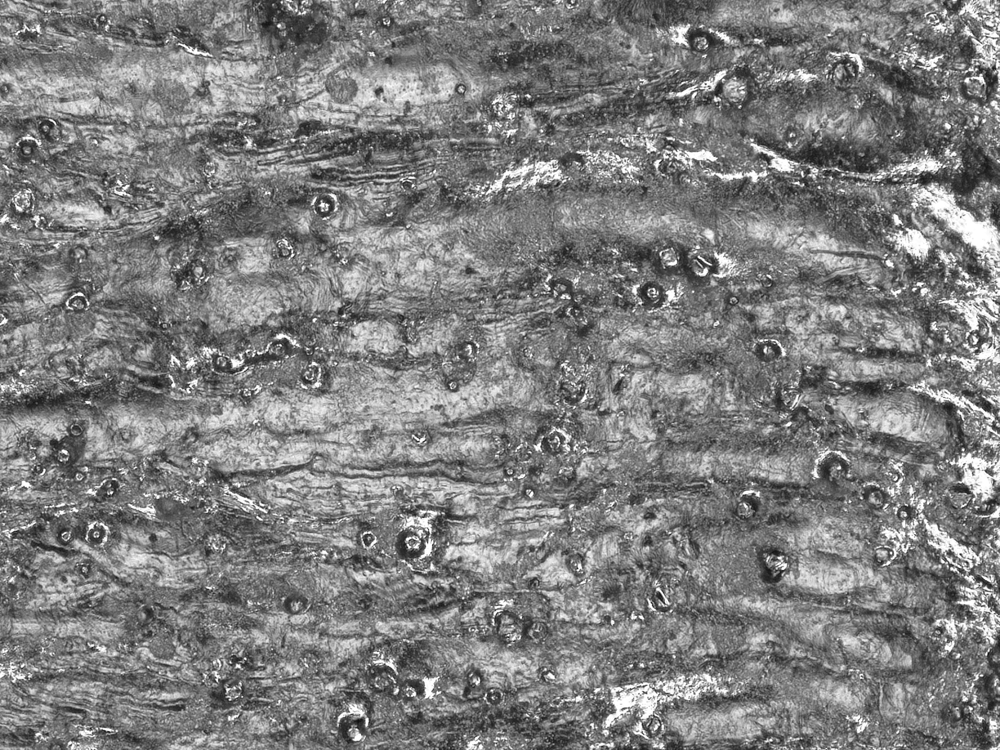

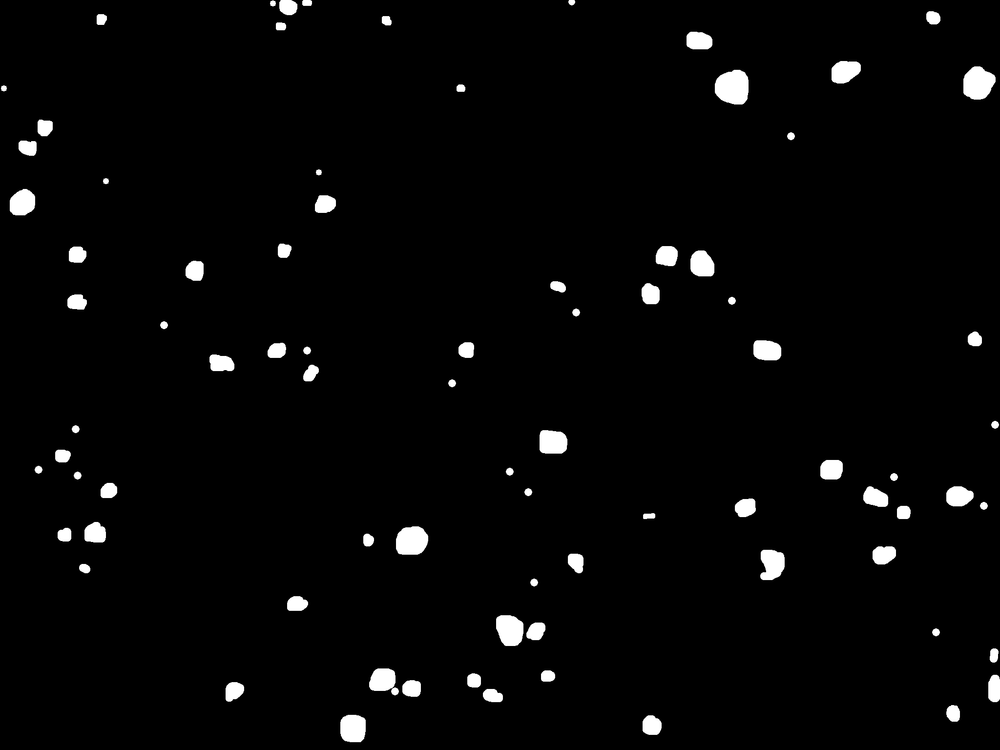

--------------------
23.tif
(1536, 2048)


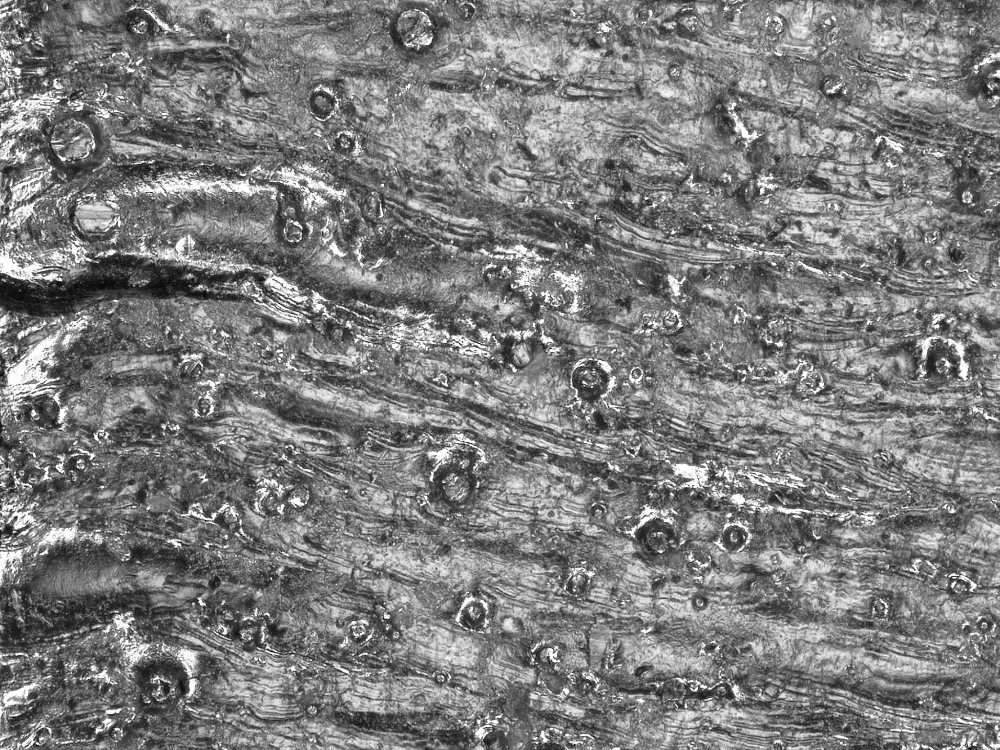

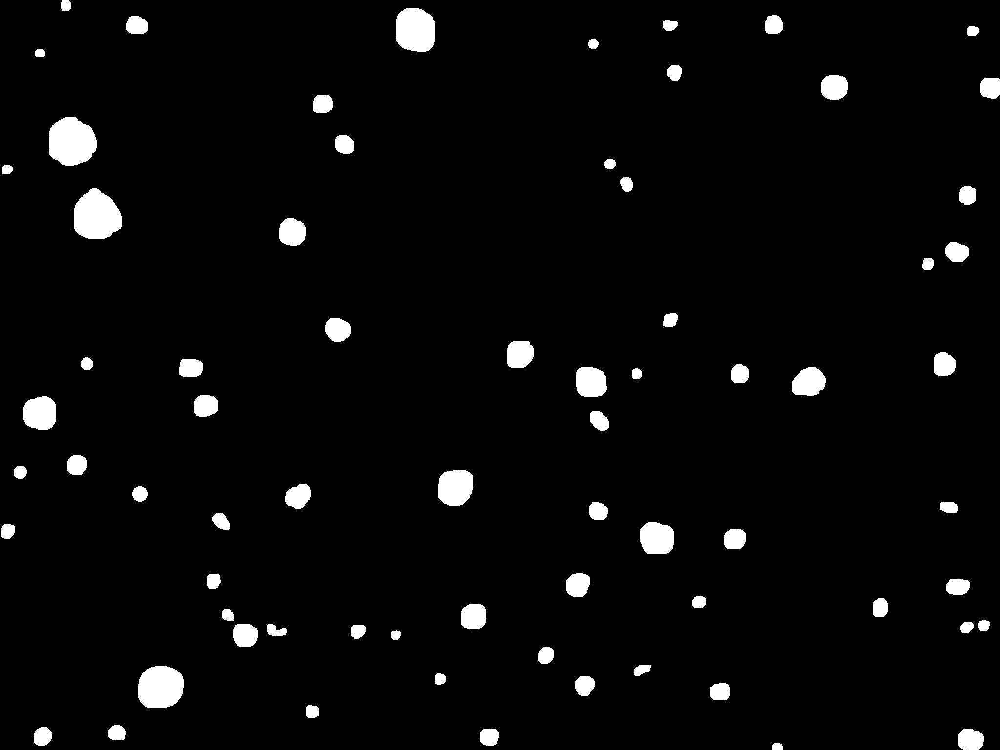

--------------------
35.tif
(1536, 2048)


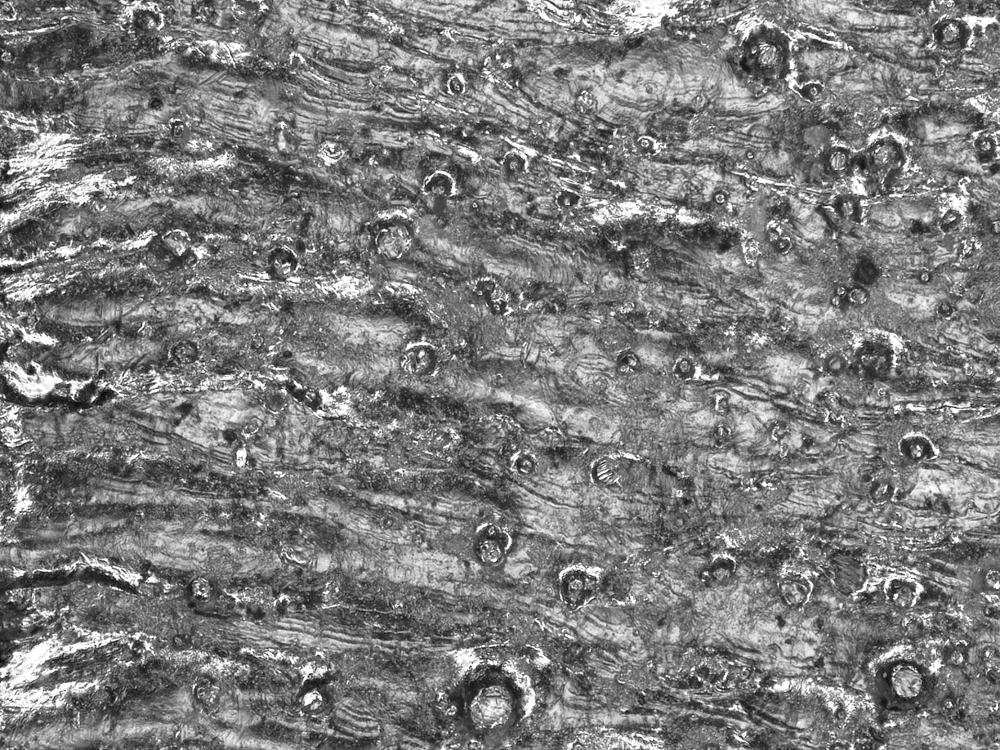

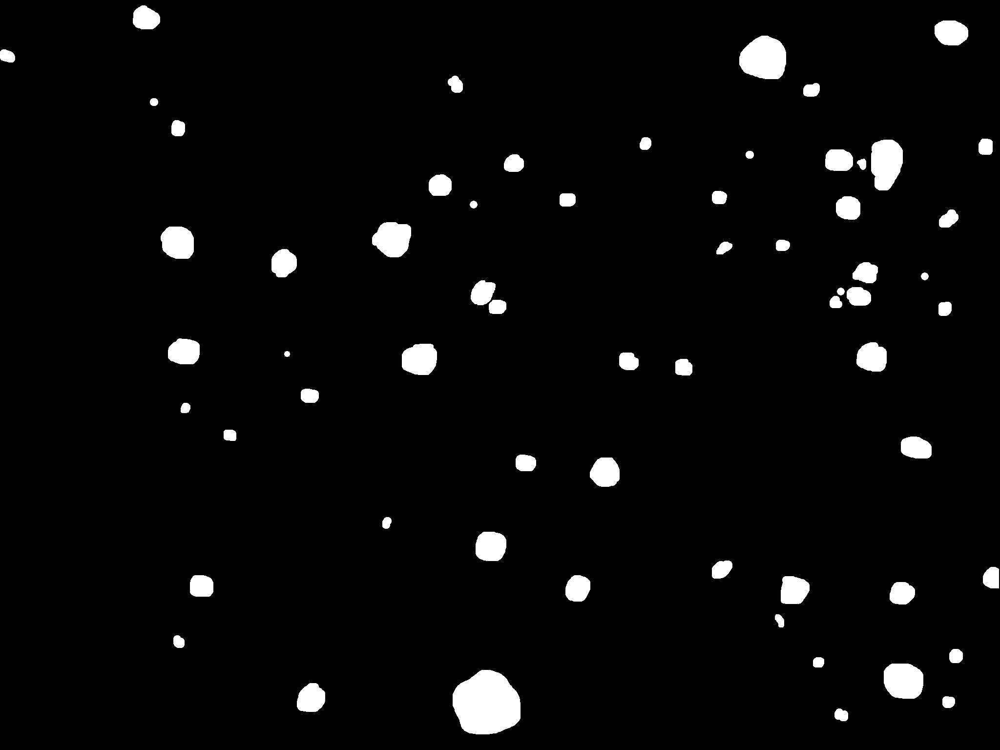

--------------------
39.tif
(1536, 2048)


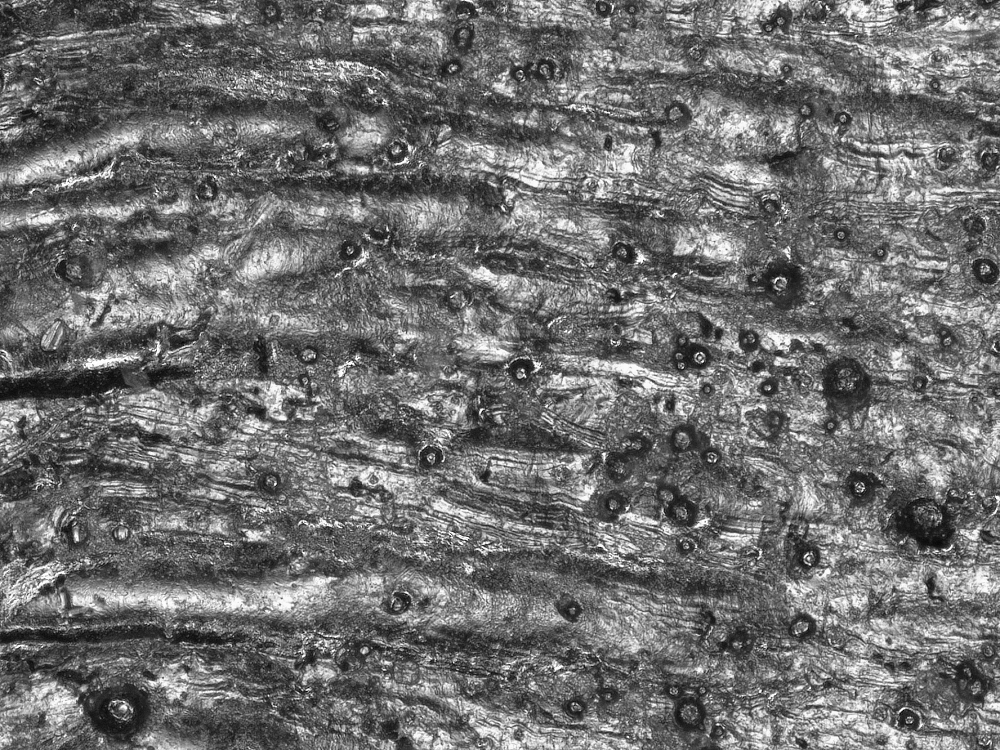

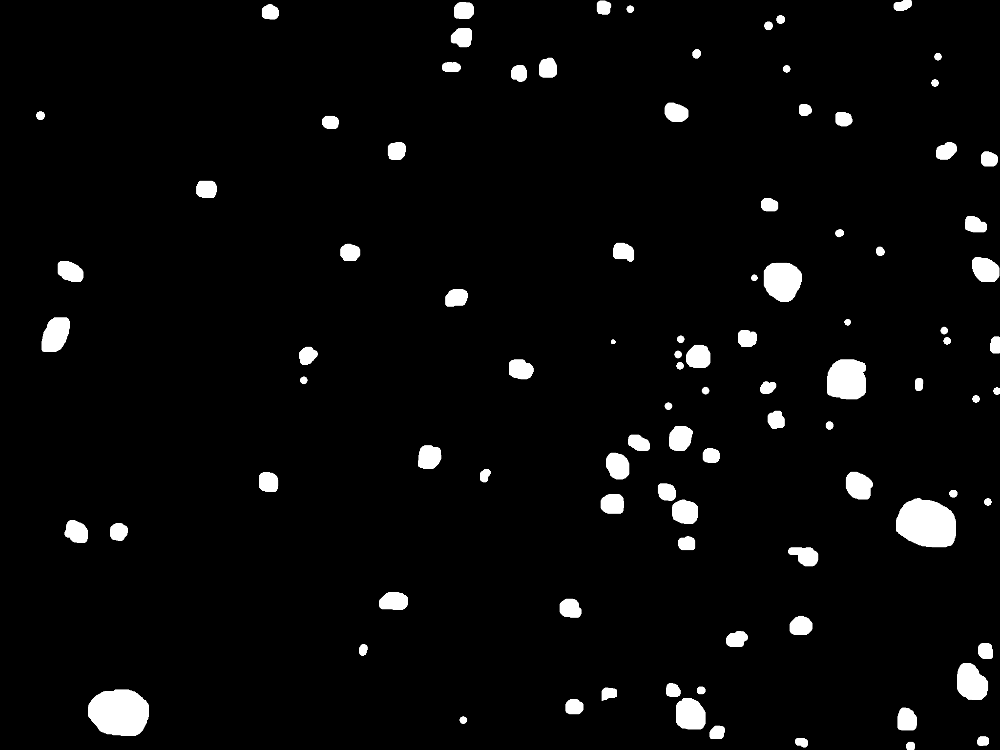

--------------------
44.tif
(1536, 2048)


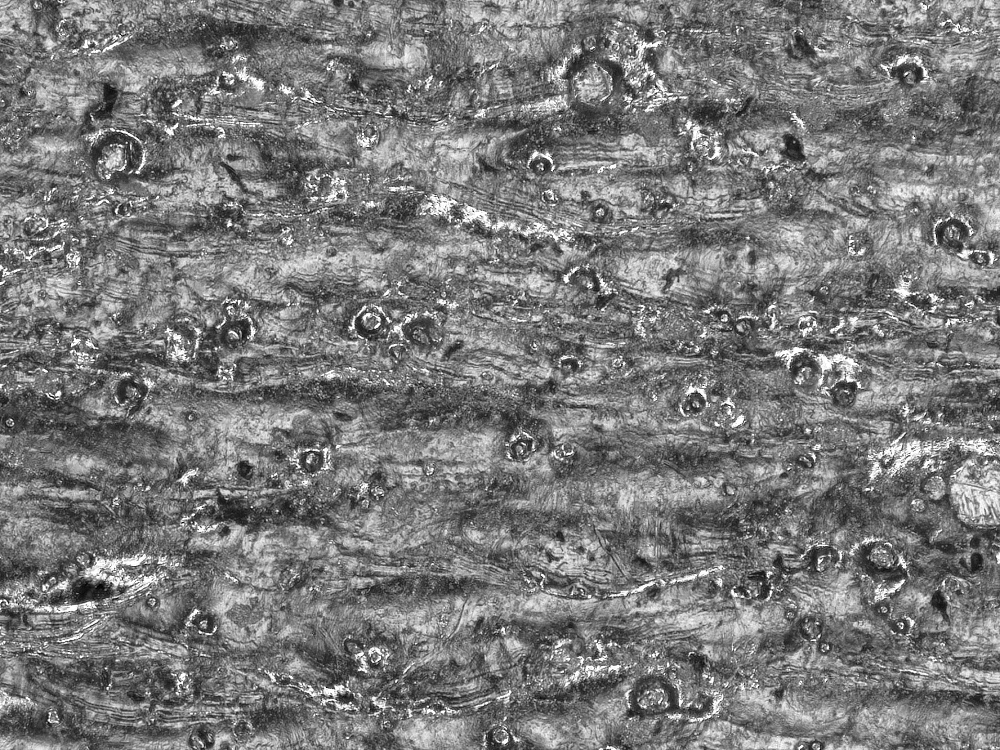

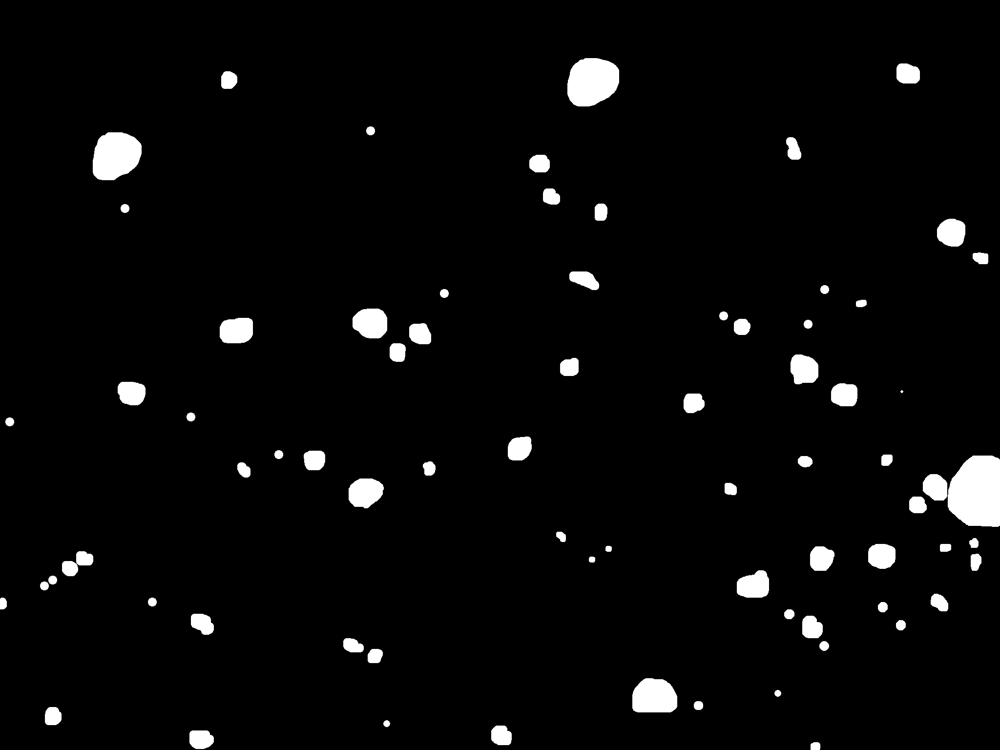

--------------------
47.tif
(1536, 2048)


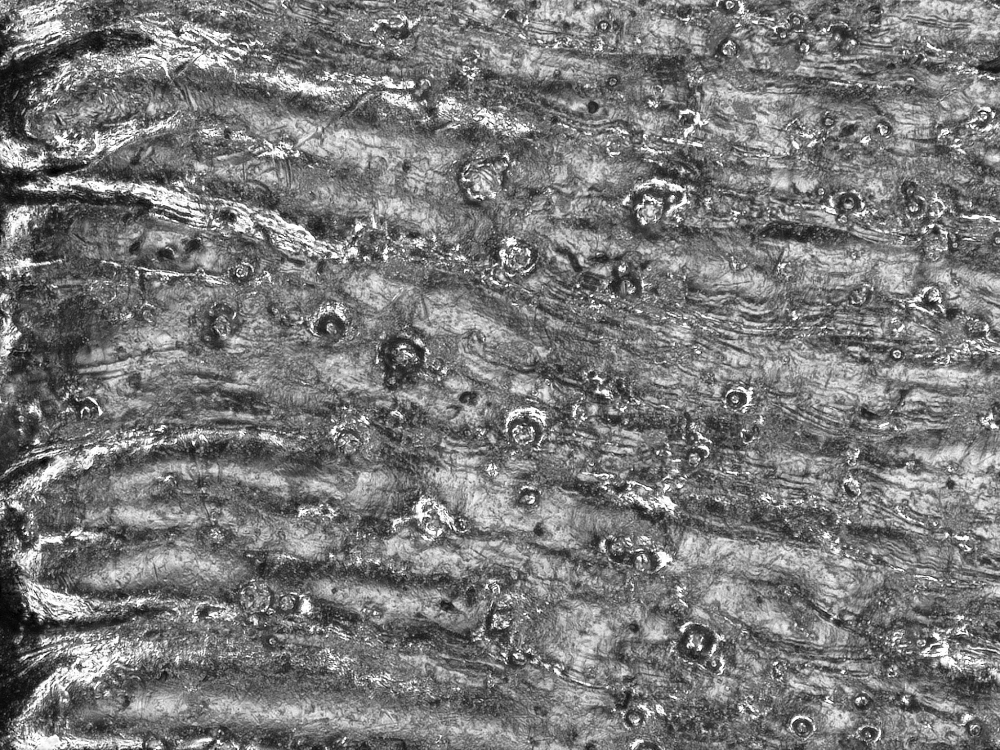

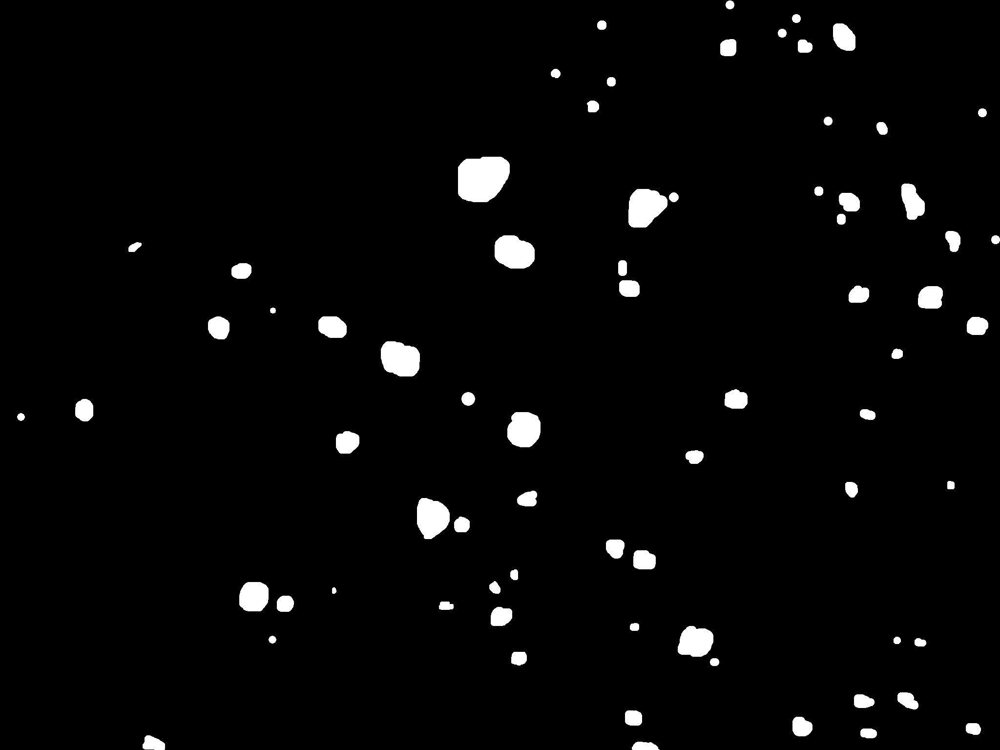

--------------------
50.tif
(1536, 2048)


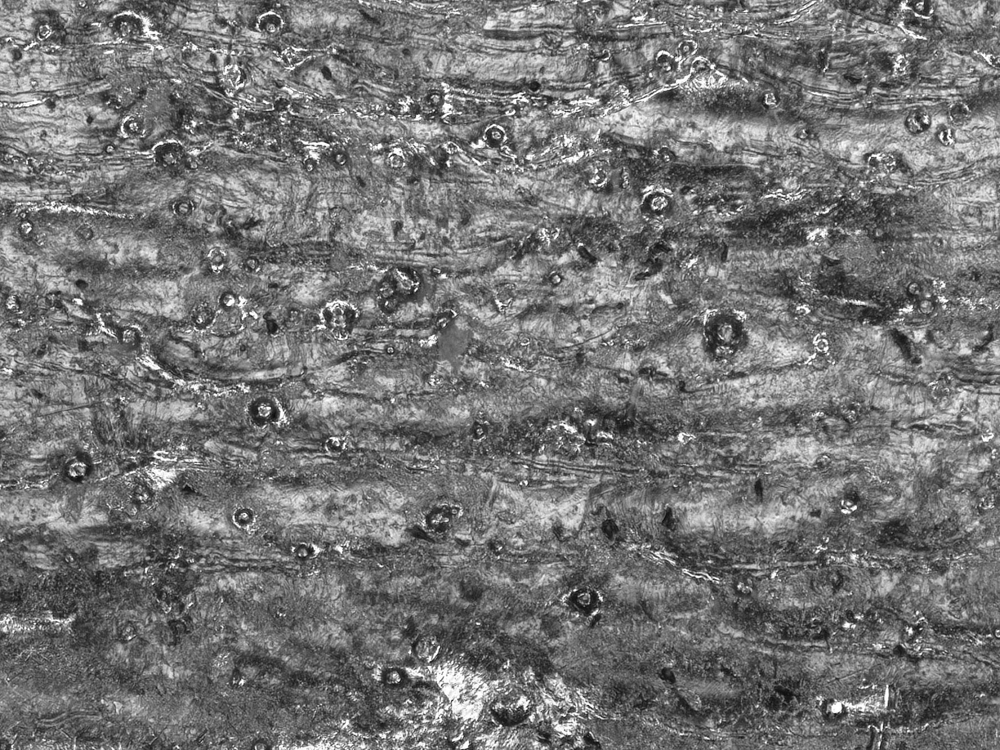

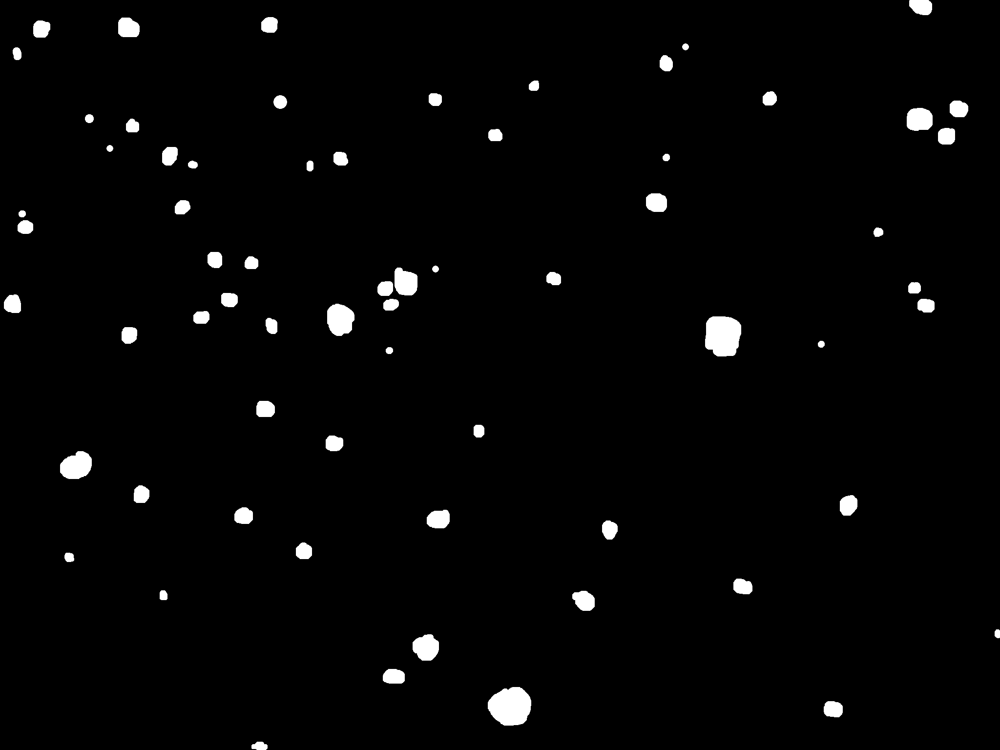

--------------------


In [ ]:
folder_img = '/content/gdrive/MyDrive/Pores_Segmentation/Input_images'
folder_msk = '/content/gdrive/MyDrive/Pores_Segmentation/output_mask'
img = []
msk = []
for filename in os.listdir(folder_img):
  print(filename)
  image = cv2.imread(folder_img+'/'+filename, cv2.IMREAD_UNCHANGED)
  gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  print(gray_image.shape)
  img.append(gray_image)
  image = cv2.imread(folder_msk+'/'+filename.split('.')[0]+'.tiff', cv2.IMREAD_UNCHANGED)
  ret, gray_image_msk = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY)
  msk.append(gray_image_msk)
  cv2_imshow(gray_image)
  cv2_imshow(gray_image_msk)
  print('--------------------')


In [ ]:
# break input image into smaller patches of 256*256
all_img_patches = []
for im in img:
  patches_img = patchify(im, (256, 256), step=256)  #Step=256 for 256 patches means no overlap
  for i in range(patches_img.shape[0]):
    for j in range(patches_img.shape[1]):
      single_patch_img = patches_img[i,j,:,:]
      single_patch_img = (single_patch_img.astype('float32')) / 255.
      all_img_patches.append(single_patch_img)
images = np.array(all_img_patches)

In [ ]:
#Convert grey image to 3 channels by copying channel 3 times.
#We do this as our unet model expects 3 channel input. 
images = np.stack((images,)*3, axis=-1)

In [ ]:
# break input Mask into smaller patches of 256*256
all_mask_patches = []
for ms in msk:
  patches_mask = patchify(ms, (256, 256), step=256)  #Step=256 for 256 patches means no overlap
  for i in range(patches_mask.shape[0]):
    for j in range(patches_mask.shape[1]):       
      single_patch_mask = patches_mask[i,j,:,:]
      single_patch_mask = single_patch_mask / 255.
      all_mask_patches.append(single_patch_mask)
      masks = np.array(all_mask_patches)
masks = np.expand_dims(masks, -1)

In [ ]:
print(images.shape)
print(masks.shape)
print("Pixel values in the mask are: ", np.unique(masks))

In [ ]:
#Define the model
BACKBONE = 'resnet34'
preprocess_input1 = sm.get_preprocessing(BACKBONE)

# preprocess input
images1=preprocess_input1(images)
print(images1.shape)

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(images1, masks, test_size = 0.25, random_state = 42)
print(X_train.shape)
print(X_test.shape)

NameError: ignored

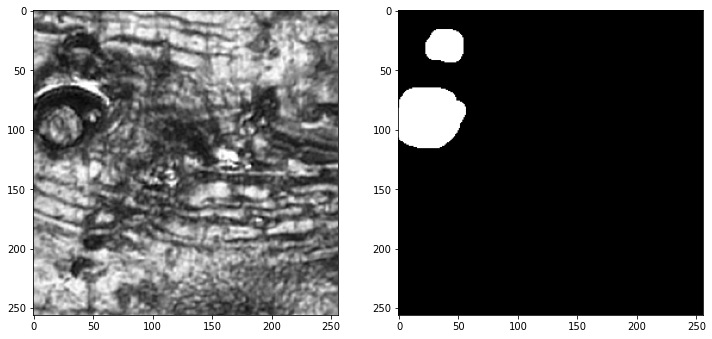

In [ ]:
#Sanity check, view few mages
image_number = random.randint(0, len(X_train))
plt.figure(figsize=(12, 6))
plt.subplot(121)
plt.imshow(X_train[image_number, :,:, 0], cmap='gray')
plt.subplot(122)
plt.imshow(np.reshape(y_train[image_number], (256, 256)), cmap='gray')
plt.show()

In [ ]:
# New generator with rotation and shear where interpolation that comes with rotation 
# and shear are thresholded in masks. 
# This gives a binary mask rather than a mask with interpolated values. 
seed=24

img_data_gen_args = dict(rotation_range=90,
                     width_shift_range=0.3,
                     height_shift_range=0.3,
                     shear_range=0.5,
                     zoom_range=0.3,
                     horizontal_flip=True,
                     vertical_flip=True,
                     fill_mode='reflect')

mask_data_gen_args = dict(rotation_range=90,
                     width_shift_range=0.3,
                     height_shift_range=0.3,
                     shear_range=0.5,
                     zoom_range=0.3,
                     horizontal_flip=True,
                     vertical_flip=True,
                     fill_mode='reflect',
                     preprocessing_function = lambda x: np.where(x>0, 1, 0).astype(x.dtype)) #Binarize the output again. 

In [ ]:
image_data_generator = ImageDataGenerator(**img_data_gen_args)
image_data_generator.fit(X_train, augment=True, seed=seed)

image_generator = image_data_generator.flow(X_train, seed=seed)
valid_img_generator = image_data_generator.flow(X_test, seed=seed)

mask_data_generator = ImageDataGenerator(**mask_data_gen_args)
mask_data_generator.fit(y_train, augment=True, seed=seed)
mask_generator = mask_data_generator.flow(y_train, seed=seed)
valid_mask_generator = mask_data_generator.flow(y_test, seed=seed)

def my_image_mask_generator(image_generator, mask_generator):
    train_generator = zip(image_generator, mask_generator)
    for (img, mask) in train_generator:
        yield (img, mask)

my_generator = my_image_mask_generator(image_generator, mask_generator)

validation_datagen = my_image_mask_generator(valid_img_generator, valid_mask_generator)

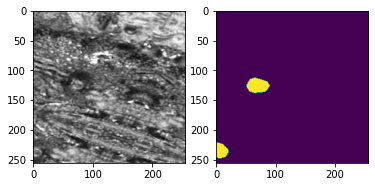

In [ ]:
# Sanity Check
x = image_generator.next()
y = mask_generator.next()
for i in range(0,1):
    image = x[i]
    mask = y[i]
    plt.subplot(1,2,1)
    plt.imshow(image[:,:,0], cmap='gray')
    plt.subplot(1,2,2)
    plt.imshow(mask[:,:,0])
    plt.show()

In [ ]:
# define TransferLerning model
# We are using UNET with backbone of resnet34 and pretrained weights of imagenet
# we are foucusing on IOU_score as its a better metrics for image segmentation tasks
model = sm.Unet(BACKBONE, encoder_weights='imagenet')
model.compile('Adam', loss=sm.losses.bce_jaccard_loss, metrics=[sm.metrics.iou_score])
print(model.summary())
model.load_weights("/content/gdrive/MyDrive/Pores_Segmentation/model_1.h5")

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 data (InputLayer)              [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 bn_data (BatchNormalization)   (None, None, None,   9           ['data[0][0]']                   
                                3)                                                                
                                                                                                  
 zero_padding2d_34 (ZeroPadding  (None, None, None,   0          ['bn_data[0][0]']                
 2D)                            3)                                                          

In [ ]:
# Fit the model
# Models often benefit from reducing the learning rate by a factor of 2-10 once learning stagnates.
# reduce_lr = ReduceLROnPlateau(monitor='loss', mode='min',factor=0.05,patience=5, min_lr=1e-6,cooldown=2,verbose = 0)

# Early stopping is used to prevent Model Overfitting
# es = EarlyStopping(monitor='loss',min_delta=0.05,mode='min', verbose=0, patience=5)

# ModelCheckpoint is used to save the best model available during training.
mc = ModelCheckpoint("/content/gdrive/MyDrive/Pores_Segmentation/model_2.h5",monitor='iou_score', mode='max', verbose=0, save_best_only=True, save_weights_only=True)
history = model.fit(my_generator, validation_data=validation_datagen, steps_per_epoch=50, validation_steps=50, epochs=100, callbacks = [mc]) #,es,reduce_lr])

Epoch 1/100
50/50 [==============================] - 67s 1s/step - loss: 0.4549 - iou_score: 0.6076 - val_loss: 0.6190 - val_iou_score: 0.4903
Epoch 2/100
50/50 [==============================] - 76s 2s/step - loss: 0.4767 - iou_score: 0.5905 - val_loss: 0.7194 - val_iou_score: 0.4119
Epoch 3/100
50/50 [==============================] - 76s 2s/step - loss: 0.5209 - iou_score: 0.5532 - val_loss: 0.6552 - val_iou_score: 0.4531
Epoch 4/100
50/50 [==============================] - 60s 1s/step - loss: 0.4843 - iou_score: 0.5840 - val_loss: 0.5758 - val_iou_score: 0.5016
Epoch 5/100
50/50 [==============================] - 61s 1s/step - loss: 0.4678 - iou_score: 0.5980 - val_loss: 0.6161 - val_iou_score: 0.4897
Epoch 6/100
50/50 [==============================] - 76s 2s/step - loss: 0.4706 - iou_score: 0.5999 - val_loss: 0.5686 - val_iou_score: 0.5289
Epoch 7/100
50/50 [==============================] - 76s 2s/step - loss: 0.4880 - iou_score: 0.5846 - val_loss: 0.6149 - val_iou_score: 0.4803

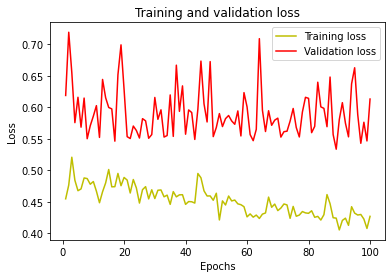

In [ ]:
#plot the training and validation accuracy and loss at each epoch
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(loss) + 1)
plt.plot(epochs, loss, 'y', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

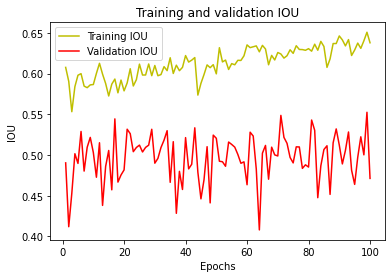

In [ ]:
# Plot IOU Score vs epoch
acc = history.history['iou_score']
val_acc = history.history['val_iou_score']

plt.plot(epochs, acc, 'y', label='Training IOU')
plt.plot(epochs, val_acc, 'r', label='Validation IOU')
plt.title('Training and validation IOU')
plt.xlabel('Epochs')
plt.ylabel('IOU')
plt.legend()
plt.show()

In [ ]:
#IOU on Test image
y_pred=model.predict(X_test)
y_pred_thresholded = y_pred > 0.5

intersection = np.logical_and(y_test, y_pred_thresholded)
union = np.logical_or(y_test, y_pred_thresholded)
iou_score = np.sum(intersection) / np.sum(union)
print("IoU socre is: ", iou_score)

5/5 [==============================] - 1s 139ms/step
IoU socre is:  0.4906082796393899


1/1 [==============================] - 0s 23ms/step


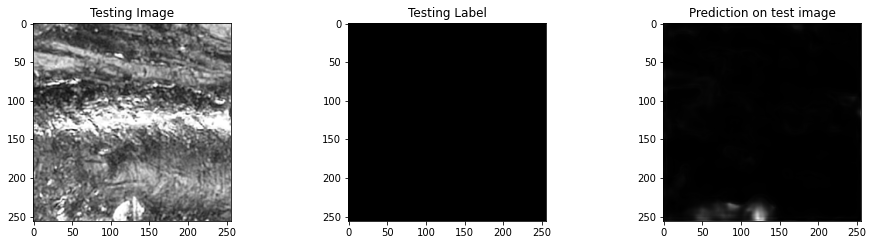

In [ ]:
# Random Samples of Test input image and Predicted Image
test_img_number = random.randint(0, len(X_test)-1)
test_img = X_test[test_img_number]
test_img_input=np.expand_dims(test_img, 0)
ground_truth=y_test[test_img_number]
prediction = model.predict(test_img_input)
prediction = prediction[0,:,:,0]

plt.figure(figsize=(16, 8))
plt.subplot(231)
plt.title('Testing Image')
plt.imshow(test_img[:,:,0], cmap='gray')
plt.subplot(232)
plt.title('Testing Label')
plt.imshow(ground_truth[:,:,0], cmap='gray')
plt.subplot(233)
plt.title('Prediction on test image')
plt.imshow(prediction, cmap='gray')

plt.show()

In [ ]:
#Apply a trained model on large image
raw_image = cv2.imread('/content/gdrive/MyDrive/Image_Segmentation/pores/test/Side2_000014.tif', cv2.IMREAD_UNCHANGED)
large_image = cv2.imread('/content/gdrive/MyDrive/Image_Segmentation/pores/test/Side2_000014.tif', 0)
#This will split the image into small images of shape [3,3]
patches = patchify(large_image, (768, 1024), step=768)  #Step=256 for 256 patches means no overlap

In [ ]:
# break test image into patches and predict
model.load_weights("/content/gdrive/MyDrive/Image_Segmentation/pores/model1.h5")
predicted_patches = []
for i in range(patches.shape[0]):
  for j in range(patches.shape[1]):
    single_patch = patches[i,j,:,:]
    single_patch_img = (single_patch.astype('float32')) / 255.
    single_patch_img = np.stack((single_patch_img,)*3, axis=-1)
    single_patch_img = single_patch_img.reshape(1,single_patch_img.shape[0],single_patch_img.shape[1],single_patch_img.shape[2])
    #Predict and threshold for values above 0.5 probability
    single_patch_prediction = (model.predict(single_patch_img)[0,:,:,0] > 0.5).astype(np.uint8)
    predicted_patches.append(single_patch_prediction)

predicted_patches = np.array(predicted_patches)

In [ ]:
# reconstruct large images from predicted patches
predicted_patches_reshaped = np.reshape(predicted_patches, (patches.shape[0], patches.shape[1], 256,256) )
reconstructed_image = unpatchify(predicted_patches_reshaped, large_image.shape)
# plt.hist(reconstructed_image.flatten())  #Threshold everything above 0
final_prediction = (reconstructed_image > 0.01).astype(np.uint8)

ret,thresh1 = cv2.threshold(reconstructed_image,0,255,cv2.THRESH_BINARY)
print(thresh1.shape)
#------------------------------------------
backtorgb = cv2.cvtColor(thresh1,cv2.COLOR_GRAY2RGB)
#-------------------------------------------

overlap_images = cv2.addWeighted(thresh1,0.62,large_image,1,0)
cv2_imshow(overlap_images)
# cv2.imwrite('/content/gdrive/MyDrive/Image_Segmentation/pores/outputs/7.tiff',overlap_images)

In [ ]:
# TEST INPUT VS OUTPUT
plt.figure(figsize=(8, 8))
plt.subplot(221)
plt.title('Large Image')
plt.imshow(large_image, cmap='gray')
plt.subplot(222)
plt.title('Prediction of large Image')
plt.imshow(reconstructed_image, cmap='gray')
plt.show()

In [ ]:
# #################################
# The model prediction could be improved by :-
# #################################

# 1. Increasing Training Data
# 2. Improving Annotation quality by better understanding the problem statement
# 3. PreProcessing - improving input quality by improving performing image denoising ,GaussianBlur for easy detection
# 4. Increasing the number of epochs, perfoming HyperTuning
# 5. Post Processing : Using WaterShed algorithm to to seperate close pores
# 6. Post Processing : Remove unwanted pores depending on their pysical properties(area, radius etc)

In [ ]:
# #################################
# #Watershed to convert semantic to instance
# #########################
# from skimage import measure, color, io
# #Watershed
# img = cv2.imread('data/results/segm.jpg')  #Read as color (3 channels)
# img_grey = img[:,:,0]
# kernel = np.ones((3,3),np.uint8)
# opening = cv2.morphologyEx(img_grey,cv2.MORPH_OPEN,kernel, iterations = 2)
# sure_bg = cv2.dilate(opening,kernel,iterations=10)
# dist_transform = cv2.distanceTransform(opening,cv2.DIST_L2,5)
# ret2, sure_fg = cv2.threshold(dist_transform, 0.5*dist_transform.max(),255,0)
# sure_fg = np.uint8(sure_fg)
# unknown = cv2.subtract(sure_bg,sure_fg)
# ret3, markers = cv2.connectedComponents(sure_fg)
# markers = markers+10
# markers[unknown==255] = 0
# markers = cv2.watershed(img, markers)
# img[markers == -1] = [0,255,255]  
# img2 = color.label2rgb(markers, bg_label=0)
# cv2.imshow('Overlay on original image', large_image)
# cv2.imshow('Colored Grains', img2)
# cv2.waitKey(0)

In [ ]:
# #################################
# Finding each Object Properties
# #################################

# props = measure.regionprops_table(markers, intensity_image=img_grey, 
#                               properties=['label',
#                                           'area', 'equivalent_diameter',
#                                           'mean_intensity', 'solidity'])
    
# import pandas as pd
# df = pd.DataFrame(props)
# df = df[df.mean_intensity > 100]  #Remove background or other regions that may be counted as objects